In [1]:
pip install mahotas

Note: you may need to restart the kernel to use updated packages.


In [2]:
import requests
import zipfile
import os
import mahotas as mh
import seaborn as sns
from matplotlib import pyplot as plt 
import numpy as np
import pandas as pd

from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler 

#Classifiers
from sklearn.linear_model import LogisticRegression 
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import ConfusionMatrixDisplay

In [3]:

# Define URL and filenames
url = "https://cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud/IBM-GPXX0UEREN/hiroshima-lemon.zip"
zip_filename = "hiroshima-lemon.zip"
extract_path = "hiroshima-lemon-data"

# Download the ZIP file
response = requests.get(url)
with open(zip_filename, "wb") as file:
    file.write(response.content)

print("Download complete!")

# Extract the ZIP file
with zipfile.ZipFile(zip_filename, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

print("Extraction complete!")


Download complete!
Extraction complete!


In [4]:
# Check extracted files
extracted_files = os.listdir(extract_path)
print("Extracted Files:", extracted_files)


Extracted Files: ['__MACOSX', 'hiroshima-lemon']


In [5]:
# Find the CSV file..
csv_files = [f for f in extracted_files if f.endswith(".csv")]

if csv_files:
    csv_path = os.path.join(extract_path, csv_files[0])  # Use the first CSV found
    df = pd.read_csv(csv_path)
    print("CSV Loaded Successfully!")
    print(df.head())  # Display first few rows
else:
    print("No CSV file found.")


No CSV file found.


In [6]:
import os

# Recursively find CSV files
csv_files = []
for root, dirs, files in os.walk(extract_path):
    for file in files:
        if file.endswith(".csv"):
            csv_files.append(os.path.join(root, file))

# Display found CSV files
if csv_files:
    print("CSV Files Found:", csv_files)
else:
    print("No CSV file found.")


CSV Files Found: ['hiroshima-lemon-data/__MACOSX/hiroshima-lemon/._test_images.csv', 'hiroshima-lemon-data/__MACOSX/hiroshima-lemon/._train_images.csv', 'hiroshima-lemon-data/hiroshima-lemon/test_images.csv', 'hiroshima-lemon-data/hiroshima-lemon/train_images.csv']


In [7]:
# Define CSV file paths
train_csv_path = "hiroshima-lemon-data/hiroshima-lemon/train_images.csv"
test_csv_path = "hiroshima-lemon-data/hiroshima-lemon/test_images.csv"

# Load CSV files
df_train = pd.read_csv(train_csv_path)
df_test = pd.read_csv(test_csv_path)

# Display first few rows of each
print("Train CSV:")
print(df_train.head())

print("\nTest CSV:")
print(df_test.head())


Train CSV:
               id  class_num
0  train_0000.jpg          0
1  train_0001.jpg          0
2  train_0002.jpg          0
3  train_0003.jpg          0
4  train_0004.jpg          0

Test CSV:
              id
0  test_0000.jpg
1  test_0001.jpg
2  test_0002.jpg
3  test_0003.jpg
4  test_0004.jpg


Reading CSV file from: hiroshima-lemon/hiroshima-lemon/train_images.csv
               id  class_num
0  train_0000.jpg          0
1  train_0001.jpg          0
2  train_0002.jpg          0
3  train_0003.jpg          0
4  train_0004.jpg          0


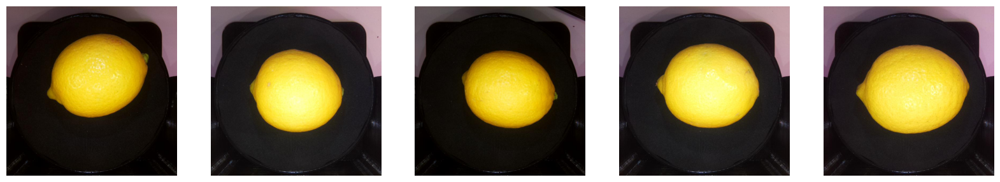

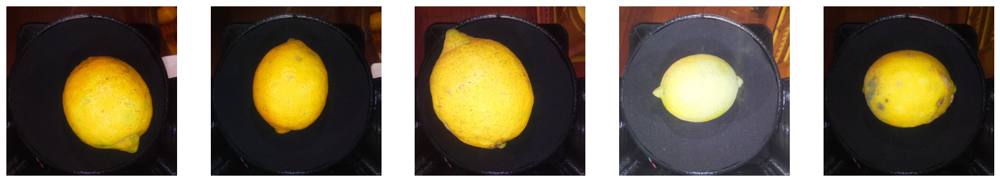

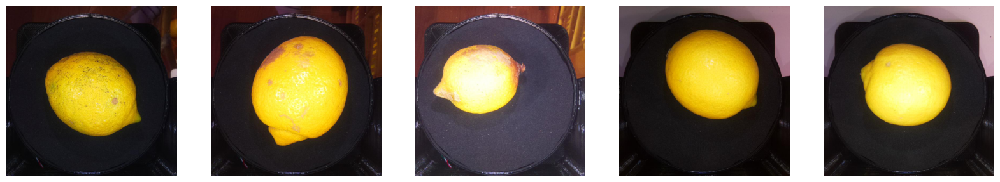

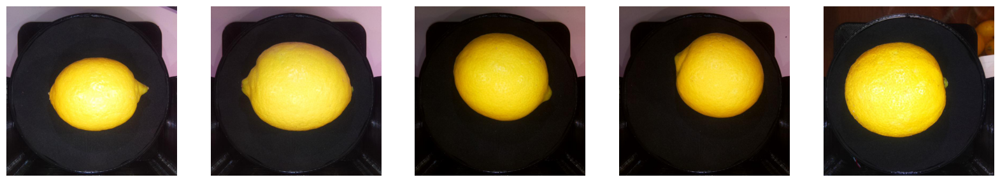

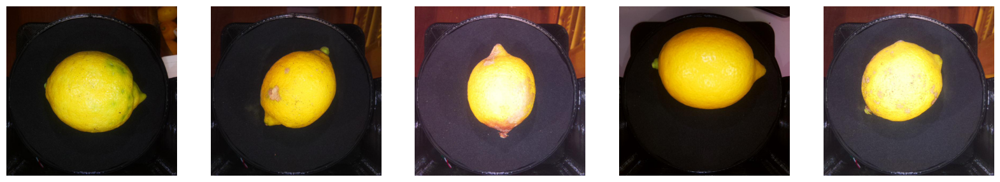

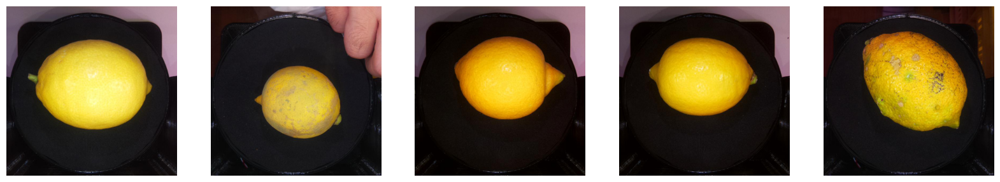

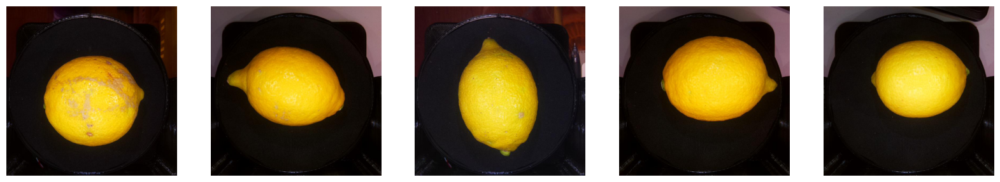

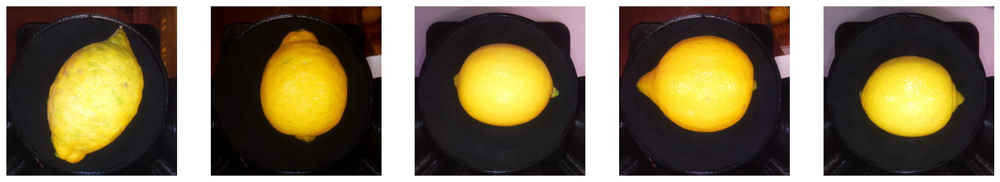

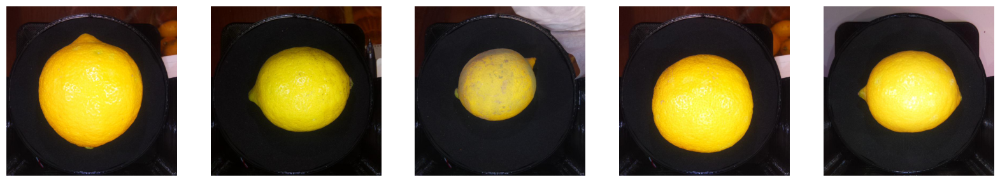

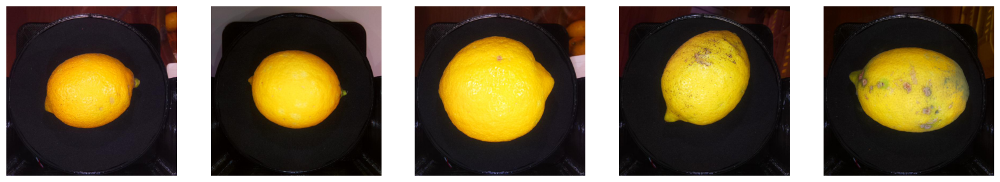

Reading CSV file from: hiroshima-lemon/hiroshima-lemon/test_images.csv
              id
0  test_0000.jpg
1  test_0001.jpg
2  test_0002.jpg
3  test_0003.jpg
4  test_0004.jpg


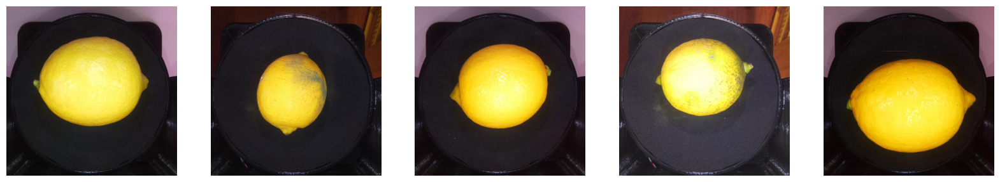

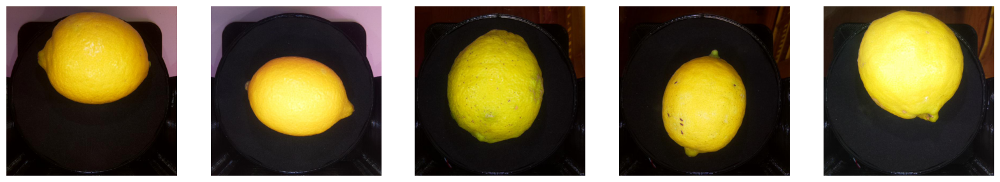

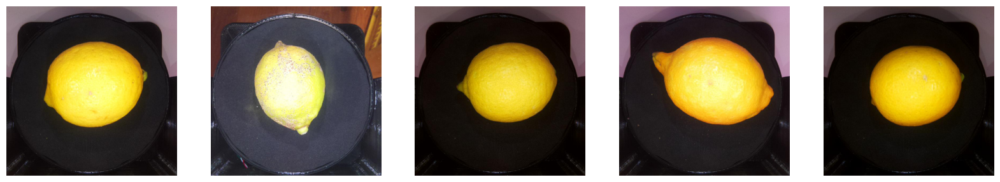

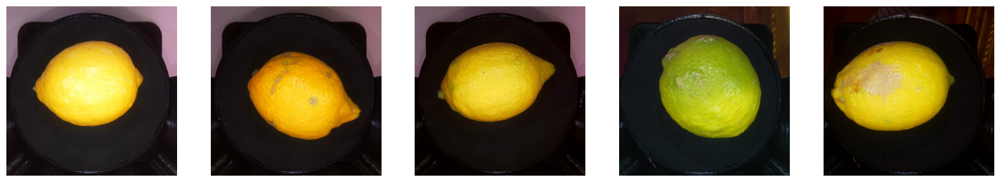

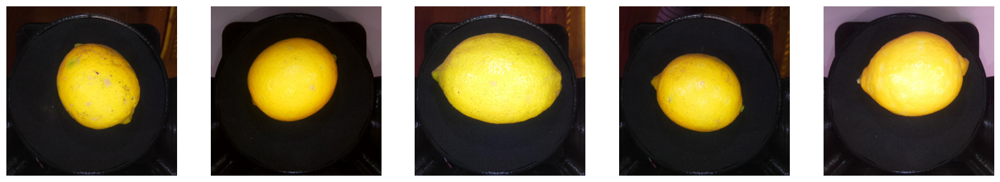

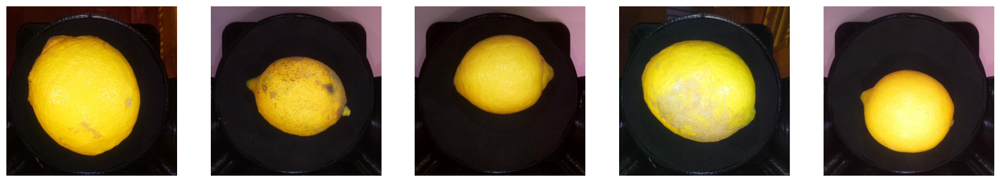

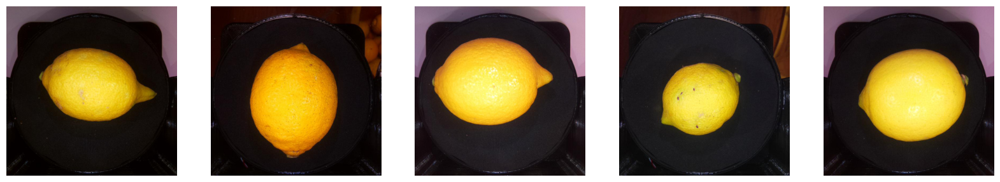

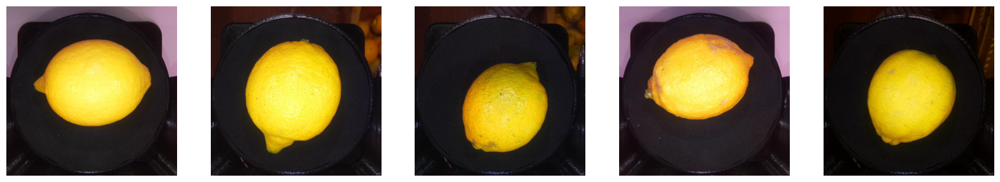

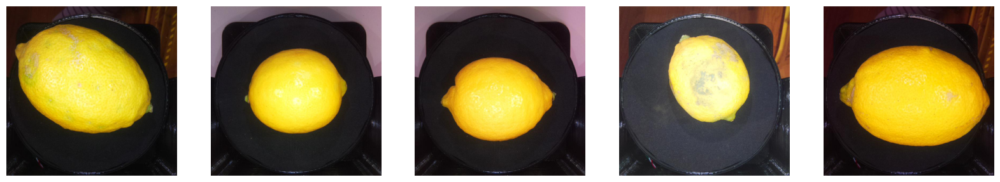

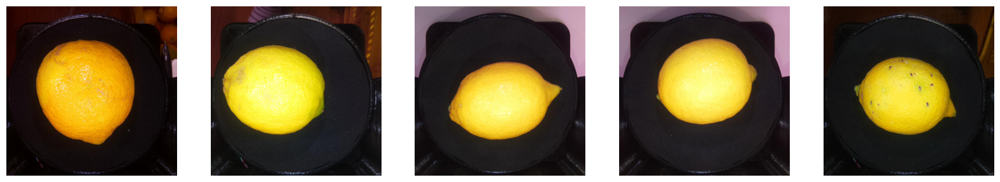

Loaded 1102 training images.
Loaded 1651 testing images.


In [24]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import mahotas as mh
import os

def get_data(folder, file, is_test=False):
    plt.rcParams["axes.grid"] = False
    data = []
    
    # Construct CSV path
    csv_path = os.path.join(folder, file + '.csv')
    
    # Check if CSV file exists
    if not os.path.exists(csv_path):
        print(f"Error: CSV file not found at {csv_path}")
        return None
    
    print("Reading CSV file from:", csv_path)
    
    # Load dataset
    ds = pd.read_csv(csv_path)
    print(ds.head())  # Debug: Display first few rows
    
    if is_test:
        if ds.shape[1] != 1:
            print("Warning: Unexpected format for test CSV.")
        filenames = ds.iloc[:, 0].values  # Extract filenames
    else:
        if ds.shape[1] != 2:
            print("Error: Training CSV file contains only one column. Expected (filename, class).")
            return None
        filenames = ds.iloc[:, 0].values  # Extract filenames
        labels = ds.iloc[:, 1].values  # Extract labels

    i, r = 0, 0
    for idx, im in enumerate(filenames):
        if i == 0 and r < 50:
            fig = plt.figure(figsize=(20, 20))  # Prepare figure for visualization
        
        # Construct image path
        image_path = os.path.join(folder, file, im)
        
        # Check if the image exists
        if not os.path.exists(image_path):
            print(f"Warning: Image file {image_path} not found, skipping...")
            continue
        
        # Load image
        image = mh.imread(image_path)
        
        if is_test:
            data.append(image)  # Only store image
        else:
            data.append((image, labels[idx]))  # Store image and label
        
        # Display a few images
        if r < 50:
            plt.subplot(1, 5, i + 1)
            plt.imshow(image)
            plt.axis("off")
        
        i += 1
        if i == 5:
            i = 0
        r += 1
    
    plt.show()
    return np.array(data) if is_test else data  # Return only images for test data

# Example Usage:
train_data = get_data("hiroshima-lemon/hiroshima-lemon", "train_images")
test_data = get_data("hiroshima-lemon/hiroshima-lemon", "test_images", is_test=True)

# Verify structure
if train_data is not None and len(train_data) > 0:
    print(f"Loaded {len(train_data)} training images.")
if test_data is not None and test_data.size > 0:
    print(f"Loaded {len(test_data)} testing images.")


Reading CSV file from: hiroshima-lemon-data/hiroshima-lemon/train_images.csv
               id  class_num
0  train_0000.jpg          0
1  train_0001.jpg          0
2  train_0002.jpg          0
3  train_0003.jpg          0
4  train_0004.jpg          0


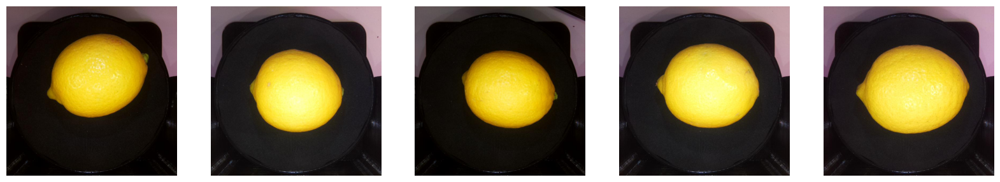

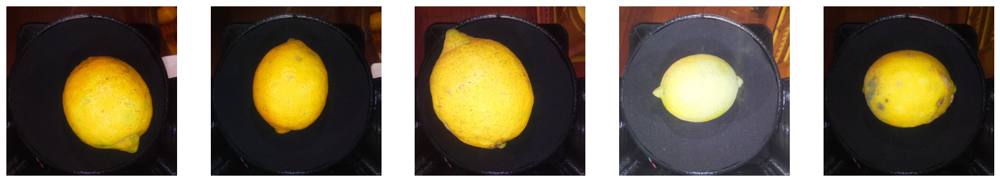

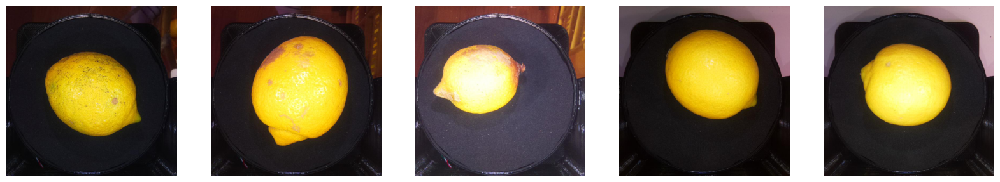

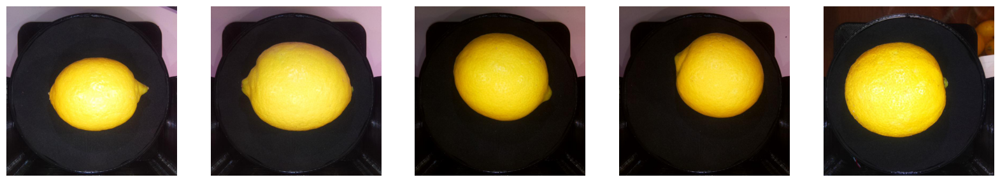

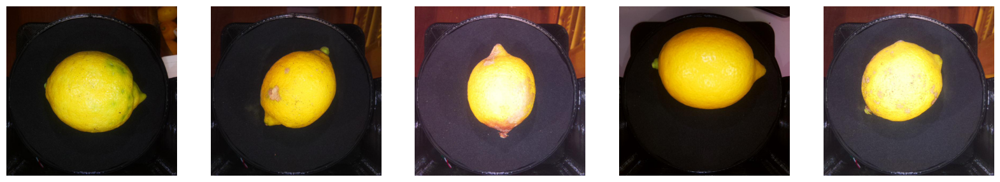

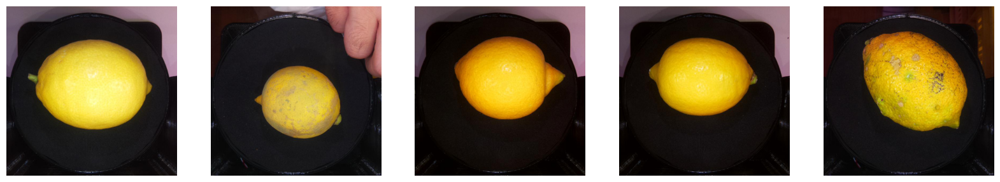

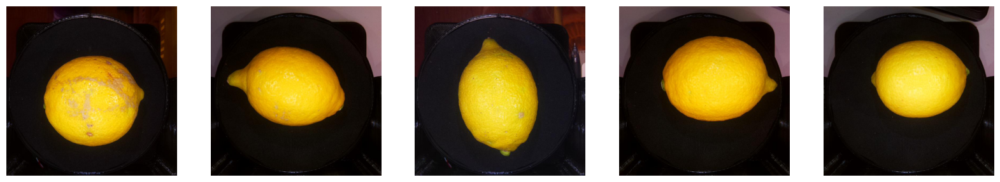

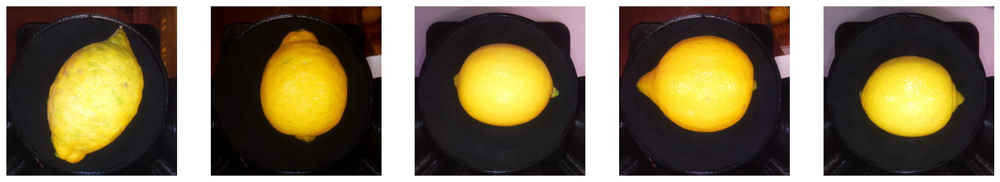

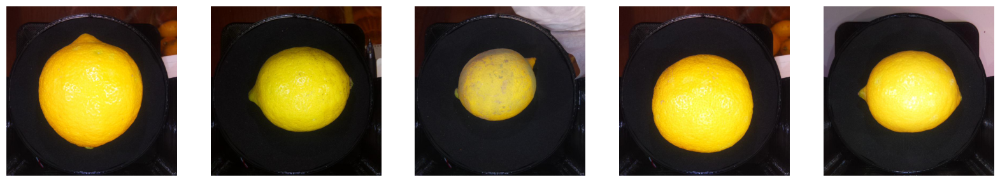

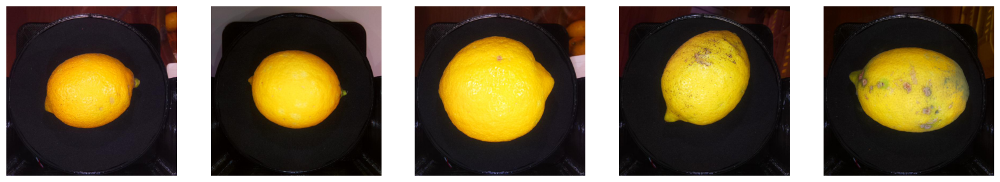

In [25]:
d = "hiroshima-lemon-data/hiroshima-lemon"  # Ensure correct folder path
f = "train_images"
train = get_data(d, f)


<Axes: xlabel='Class', ylabel='count'>

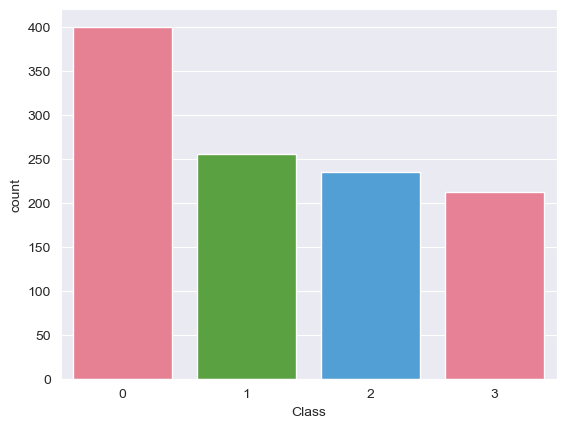

In [26]:
train_array = np.array(train, dtype=object)  
c = pd.DataFrame(train_array[:, 1], columns=['Class'])  
sns.set_style('darkgrid') 
#sns.countplot(x="Class", data=c, palette="husl")  
sns.countplot(x="Class", data=c, hue="Class", palette="husl", legend=False)  


In [27]:
### As you can see, the DataSet consist of 4 classes of lemon quality, denoted in the data set by codes from 0 to 3. 
### For a better understanding and correct results visualization, let's create a dictionary describing each of these classes.

In [28]:
class_names = {0: 'excellent', 1: 'good', 2: 'processed products', 3: 'disqualified'}

In [29]:
train_array = np.array(train, dtype=object)  

im_train, im_val, c_train, c_val = train_test_split(
    train_array[:, 0], train_array[:, 1], test_size=0.3, shuffle=True
)

c_train = c_train.astype(int)  
c_val = c_val.astype(int)  


In [30]:
print("Train shape", im_train.shape) # Size of the training DataSet
print("Test shape", im_val.shape) # Size of the test DataSet


Train shape (771,)
Test shape (331,)


In [31]:
print(train_array.shape)  # Should be (1102, 2)


(1102, 2)


<Axes: xlabel='Train Class Name', ylabel='count'>

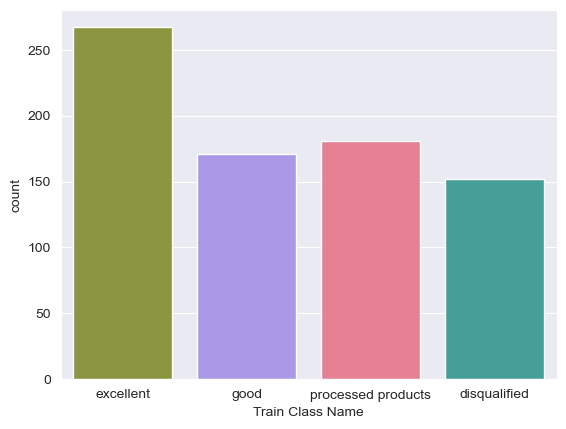

In [32]:
c = pd.DataFrame(c_train, columns=['Train Class'])  
c['Train Class Name'] = c['Train Class'].map(class_names)  

sns.set_style('darkgrid')  
#sns.countplot(x="Train Class Name", data=c, order=['excellent', 'good', 'processed products', 'disqualified']) 
sns.countplot(x="Train Class Name", data=c, order=['excellent', 'good', 'processed products', 'disqualified'], hue="Train Class Name",palette="husl")  



/var/folders/hz/nynnmh0x1zvgl0y3flgvxpnh0000gn/T/ipykernel_33414/2997390437.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x="Validate Class Name", data=c, order=['excellent', 'good', 'processed products', 'disqualified'], palette="husl")


<Axes: xlabel='Validate Class Name', ylabel='count'>

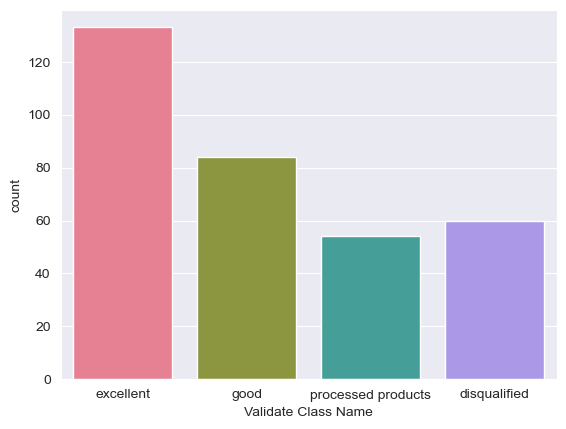

In [33]:
c = pd.DataFrame(c_val, columns=['Train Class'])  
c['Validate Class Name'] = c['Train Class'].map(class_names)  

sns.set_style('darkgrid')  
sns.countplot(x="Validate Class Name", data=c, order=['excellent', 'good', 'processed products', 'disqualified'], palette="husl")  


Quality of lemon
excellent


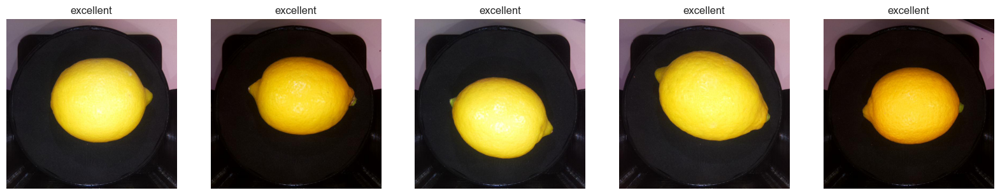

good


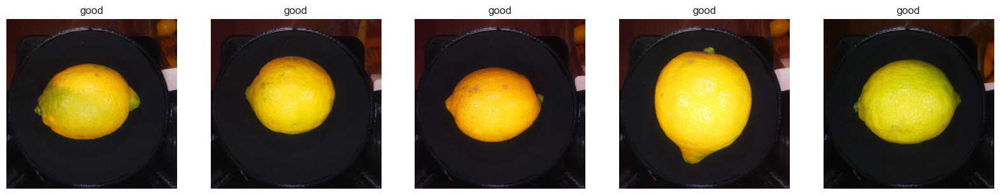

processed products


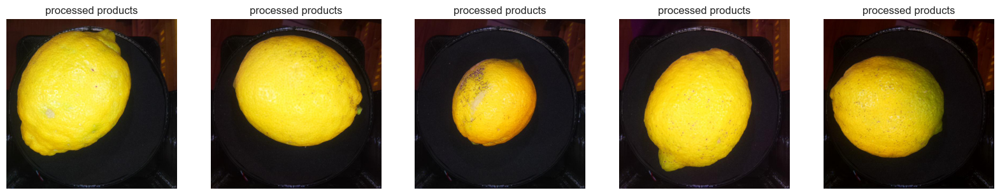

disqualified


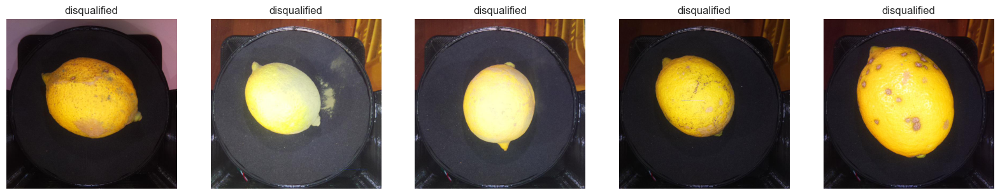

In [34]:
print("Quality of lemon")  
plt.rcParams["axes.grid"] = False  

for c in class_names:  
    ims = np.where(c_train == c)[0][:5]  
    print(class_names[c])  
    fig = plt.figure(figsize=(20, 20))  

    for i, im in enumerate(ims):  
        plt.subplot(1, 5, i + 1)  
        plt.imshow(im_train[im])  
        plt.title(class_names[c])  
        plt.axis("off")  

    plt.show()  


In [35]:
def create_features(im):
    features = []
    for image in im:
        im_grey = mh.colors.rgb2grey(image, dtype = np.uint8)
        features.append(mh.features.haralick(im_grey).ravel())
    features = np.array(features)
    return (features) 

In [36]:
features_train = create_features(im_train)
features_val = create_features(im_val)

In [37]:
print(features_train.shape)
print(features_val.shape)

(771, 52)
(331, 52)


In [38]:
""" Comparing different classical classification methods

If we want to compare some classifiers, we should use a Pipeline. A Pipeline can be used to chain multiple estimators into one. This is useful as there is often a fixed sequence of steps in data processing, for example, feature selection, normalization and classification. A pipeline serves multiple purposes here:

You only have to call fit() once to evaluate a whole sequence of estimators.

You can grid search over parameters of all estimators in the pipeline at once.

Pipelines help to avoid leaking statistics from your test data into the trained model in cross-validation by ensuring that the same samples are used to train the transformers and predictors. All estimators in a pipeline, except the last one, should be transformers (i.e. should have a transform method). The last estimator may be of any type (transformer, classifier, etc.).

The sklearn.pipeline module implements utilities to build a composite estimator, as a chain of transforms and estimators.

The fit() and score() functions are used for training and evaluating the accuracy, this is an example of OOP polymorphism.

In order to test how it works we will use LogisticRegression.

We will use function ConfusionMatrixDisplay.from_estimator() for the analysis.
"""

' Comparing different classical classification methods\n\nIf we want to compare some classifiers, we should use a Pipeline. A Pipeline can be used to chain multiple estimators into one. This is useful as there is often a fixed sequence of steps in data processing, for example, feature selection, normalization and classification. A pipeline serves multiple purposes here:\n\nYou only have to call fit() once to evaluate a whole sequence of estimators.\n\nYou can grid search over parameters of all estimators in the pipeline at once.\n\nPipelines help to avoid leaking statistics from your test data into the trained model in cross-validation by ensuring that the same samples are used to train the transformers and predictors. All estimators in a pipeline, except the last one, should be transformers (i.e. should have a transform method). The last estimator may be of any type (transformer, classifier, etc.).\n\nThe sklearn.pipeline module implements utilities to build a composite estimator, as 

Training DataSet accuracy:  92.7% Test DataSet accuracy:  94.6%


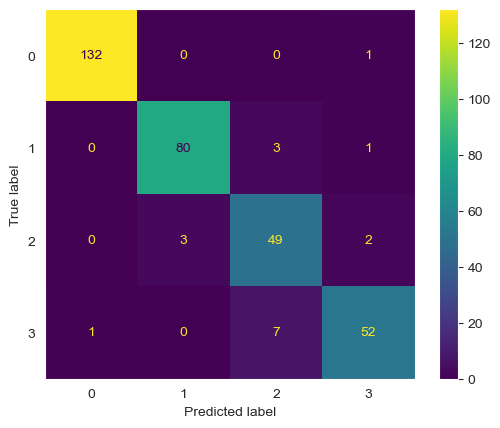

In [39]:
clf = Pipeline([('preproc', StandardScaler()), ('classifier', LogisticRegression(max_iter=1000))])
clf.fit(features_train, c_train)
scores_train = clf.score(features_train, c_train)
scores_val = clf.score(features_val, c_val)
print('Training DataSet accuracy: {: .1%}'.format(scores_train), 'Test DataSet accuracy: {: .1%}'.format(scores_val))
ConfusionMatrixDisplay.from_estimator(clf, features_val, c_val)  
plt.show() 


In [40]:
'''
As you can see, the results are not bad. Conflusion matrix shows us how many mistaken predictions we got. It allows us to check other classifiers and compare the results. We will test:

    Logistic Regression
    Nearest Neighbors
    Linear SVM
    RBF SVM
    Gaussian Process
    Decision Tree
    Random Forest
    Multi-layer Perceptron classifier
    Ada Boost
    Naive Bayes
    Quadratic Discriminant Analysis
'''


'\nAs you can see, the results are not bad. Conflusion matrix shows us how many mistaken predictions we got. It allows us to check other classifiers and compare the results. We will test:\n\n    Logistic Regression\n    Nearest Neighbors\n    Linear SVM\n    RBF SVM\n    Gaussian Process\n    Decision Tree\n    Random Forest\n    Multi-layer Perceptron classifier\n    Ada Boost\n    Naive Bayes\n    Quadratic Discriminant Analysis\n'

In [41]:
names = ["Logistic Regression", "Nearest Neighbors", "Linear SVM", "RBF SVM", "Gaussian Process",
         "Decision Tree", "Random Forest", "Neural Net", "AdaBoost",
         "Naive Bayes", "QDA"]

classifiers = [
    LogisticRegression(max_iter=1000),
    KNeighborsClassifier(3),
    SVC(kernel="linear", C=0.025),
    SVC(gamma=2, C=1),
    GaussianProcessClassifier(1.0 * RBF(1.0)),
    DecisionTreeClassifier(max_depth=5),
    RandomForestClassifier(max_depth=5, n_estimators=10, max_features=1),
    MLPClassifier(alpha=1, max_iter=1000),
    AdaBoostClassifier(),
    GaussianNB(),
    QuadraticDiscriminantAnalysis()]
scores_train = []
scores_val = []
for name, clf in zip(names, classifiers):
    print("Fitting:", name)
    clf = Pipeline([('preproc', StandardScaler()), ('classifier', clf)])
    clf.fit(features_train, c_train)
    score_train = clf.score(features_train, c_train)
    score_val = clf.score(features_val, c_val)
    scores_train.append(score_train)
    scores_val.append(score_val)

Fitting: Logistic Regression
Fitting: Nearest Neighbors
Fitting: Linear SVM
Fitting: RBF SVM
Fitting: Gaussian Process


/opt/anaconda3/lib/python3.12/site-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


Fitting: Decision Tree
Fitting: Random Forest
Fitting: Neural Net
Fitting: AdaBoost


/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Fitting: Naive Bayes
Fitting: QDA


/opt/anaconda3/lib/python3.12/site-packages/sklearn/discriminant_analysis.py:947: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


In [42]:
res = pd.DataFrame(index = names)
res['scores_train'] = scores_train
res['scores_val'] = scores_val
res.columns = ['Test','Validate']
res.index.name = "Classifier accuracy"
pd.options.display.float_format = '{:,.2f}'.format
print(res)

                     Test  Validate
Classifier accuracy                
Logistic Regression  0.93      0.95
Nearest Neighbors    0.94      0.87
Linear SVM           0.78      0.82
RBF SVM              1.00      0.83
Gaussian Process     1.00      0.98
Decision Tree        0.83      0.76
Random Forest        0.80      0.77
Neural Net           0.96      0.95
AdaBoost             0.68      0.67
Naive Bayes          0.68      0.71
QDA                  1.00      0.98


In [43]:
print("Scores Train:", scores_train)
print("Scores Val:", scores_val)


Scores Train: [0.9273670557717251, 0.9351491569390402, 0.7821011673151751, 0.9987029831387808, 1.0, 0.833981841763943, 0.7989623865110247, 0.9584954604409858, 0.6783398184176395, 0.6796368352788587, 1.0]
Scores Val: [0.945619335347432, 0.8700906344410876, 0.8187311178247734, 0.8338368580060423, 0.9788519637462235, 0.7552870090634441, 0.7734138972809668, 0.9516616314199395, 0.6706948640483383, 0.7069486404833837, 0.9788519637462235]


In [44]:
print(name, score_train, score_val)  # Inside the loop before appending


QDA 1.0 0.9788519637462235


In [45]:
for name, clf in zip(names, classifiers):
    print("Fitting:", name)
    clf = Pipeline([('preproc', StandardScaler()), ('classifier', clf)])
    clf.fit(features_train, c_train)
    
    score_train = clf.score(features_train, c_train)
    score_val = clf.score(features_val, c_val)
    
    print(name, score_train, score_val)  # Debug print
    
    scores_train.append(score_train)
    scores_val.append(score_val)

print("Final Scores Train:", scores_train)
print("Final Scores Val:", scores_val)


Fitting: Logistic Regression
Logistic Regression 0.9273670557717251 0.945619335347432
Fitting: Nearest Neighbors
Nearest Neighbors 0.9351491569390402 0.8700906344410876
Fitting: Linear SVM
Linear SVM 0.7821011673151751 0.8187311178247734
Fitting: RBF SVM
RBF SVM 0.9987029831387808 0.8338368580060423
Fitting: Gaussian Process


/opt/anaconda3/lib/python3.12/site-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


Gaussian Process 1.0 0.9788519637462235
Fitting: Decision Tree
Decision Tree 0.833981841763943 0.7643504531722054
Fitting: Random Forest
Random Forest 0.8287937743190662 0.7854984894259819
Fitting: Neural Net
Neural Net 0.9559014267185474 0.9516616314199395
Fitting: AdaBoost


/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


AdaBoost 0.6783398184176395 0.6706948640483383
Fitting: Naive Bayes
Naive Bayes 0.6796368352788587 0.7069486404833837
Fitting: QDA
QDA 1.0 0.9788519637462235
Final Scores Train: [0.9273670557717251, 0.9351491569390402, 0.7821011673151751, 0.9987029831387808, 1.0, 0.833981841763943, 0.7989623865110247, 0.9584954604409858, 0.6783398184176395, 0.6796368352788587, 1.0, 0.9273670557717251, 0.9351491569390402, 0.7821011673151751, 0.9987029831387808, 1.0, 0.833981841763943, 0.8287937743190662, 0.9559014267185474, 0.6783398184176395, 0.6796368352788587, 1.0]
Final Scores Val: [0.945619335347432, 0.8700906344410876, 0.8187311178247734, 0.8338368580060423, 0.9788519637462235, 0.7552870090634441, 0.7734138972809668, 0.9516616314199395, 0.6706948640483383, 0.7069486404833837, 0.9788519637462235, 0.945619335347432, 0.8700906344410876, 0.8187311178247734, 0.8338368580060423, 0.9788519637462235, 0.7643504531722054, 0.7854984894259819, 0.9516616314199395, 0.6706948640483383, 0.7069486404833837, 0.9788

/opt/anaconda3/lib/python3.12/site-packages/sklearn/discriminant_analysis.py:947: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


In [46]:
print("Final Scores Train Length:", len(scores_train))
print("Final Scores Val Length:", len(scores_val))
print("Expected Length:", len(names))  # Should be 11

if len(scores_train) == len(names) and len(scores_val) == len(names):
    x = np.arange(len(names))  # Label locations
    width = 0.35  # Width of the bars

    fig, ax = plt.subplots()
    rects1 = ax.bar(x - width/2, scores_train, width, label='Train')
    rects2 = ax.bar(x + width/2, scores_val, width, label='Test')

    ax.set_ylabel('Accuracy')
    ax.set_title('Accuracy of classifiers')
    ax.set_xticks(x)
    plt.xticks(rotation=90)
    ax.set_xticklabels(names)
    ax.legend()

    plt.show()
else:
    print("Mismatch in list lengths, check for errors in classifier loop.")



Final Scores Train Length: 22
Final Scores Val Length: 22
Expected Length: 11
Mismatch in list lengths, check for errors in classifier loop.


In [47]:
"""Lemon quality classification report

Let's create a report. In order to classify a set of lemon images, we should do the following:

    Download the images
    Create a DataSet of features
    Make a classification
    Save the results in a file.
"""

"Lemon quality classification report\n\nLet's create a report. In order to classify a set of lemon images, we should do the following:\n\n    Download the images\n    Create a DataSet of features\n    Make a classification\n    Save the results in a file.\n"

In [48]:
#might need to re-run

# Path to the zip file
zip_path = "hiroshima-lemon.zip"
extract_folder = "hiroshima-lemon"

# Extract if not already extracted
if not os.path.exists(extract_folder):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_folder)

# Check if extraction was successful
print("Exists:", os.path.exists(extract_folder))
print("Contents:", os.listdir(extract_folder))


Exists: True
Contents: ['__MACOSX', 'hiroshima-lemon']


In [49]:
def get_test_data(folder, file):
    data = []
    csv_path = os.path.join(folder, file + '.csv')
    print(f"Reading CSV: {csv_path}")

    ds = pd.read_csv(csv_path)

    for im in ds.values:
        image_path = os.path.join(folder, file, im[0])  # Ensure correct file structure
        if os.path.exists(image_path):  
            image = mh.imread(image_path)
            data.append(image)
        else:
            print(f"Warning: File {image_path} not found!")

    return np.array(data)


In [50]:
import os

d = "hiroshima-lemon"
f = "test_images"
folder_path = os.path.join(d, f)

# Check if the directory exists and list files
if os.path.exists(folder_path):
    print("Files in test_images:", os.listdir(folder_path))
else:
    print("Path does not exist:", folder_path)


Path does not exist: hiroshima-lemon/test_images


In [51]:
print("Exists:", os.path.exists("hiroshima-lemon"))


Exists: True


In [52]:
d = "hiroshima-lemon/hiroshima-lemon"
print("Exists:", os.path.exists(d))
print("Contents:", os.listdir(d))


Exists: True
Contents: ['test_images', 'test_images.csv', 'train_images.csv', '.DS_Store', 'train_images']


In [53]:
d = "hiroshima-lemon/hiroshima-lemon"  # Adjusted path
f = "test_images"
test = get_test_data(d, f)


Reading CSV: hiroshima-lemon/hiroshima-lemon/test_images.csv


In [54]:
def get_test_data(folder, file):
    data = []
    csv_path = f"{folder}/{file}.csv"
    print(f"Reading CSV: {csv_path}")
    
    ds = pd.read_csv(csv_path)
    
    for im in ds.values:        
        img_path = f"{folder}/{file}/{im[0]}"
        print(f"Loading Image: {img_path}")
        
        if os.path.exists(img_path):
            image = mh.imread(img_path)
            data.append(image)
        else:
            print(f"Image not found: {img_path}")
    
    return np.array(data)


In [55]:
features_test = create_features(test)

In [56]:
print(test.shape)
print(features_test.shape)

(1651, 640, 640, 3)
(1651, 52)


In [57]:
### Data shapes indicate that:

###    You have 1651 images, each of 640x640 pixels with 3 color channels (RGB).
###    You extracted 52 features per image.

In [58]:
### making a classification
clf = Pipeline([('preproc', StandardScaler()), ('classifier', LogisticRegression(max_iter=1000))])
clf.fit(features_train, c_train)

Pipeline(steps=[('preproc', StandardScaler()),
                ('classifier', LogisticRegression(max_iter=1000))])

In [60]:
c_test = clf.predict(features_test)
c_test

array([0, 3, 0, ..., 2, 0, 0])

Classification results
excellent


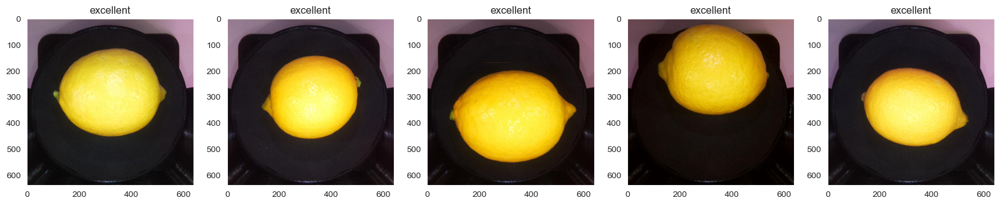

good


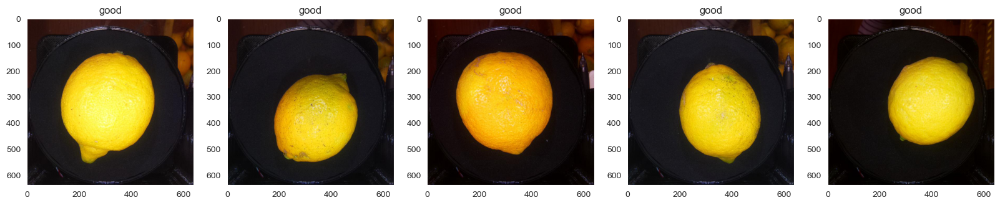

processed products


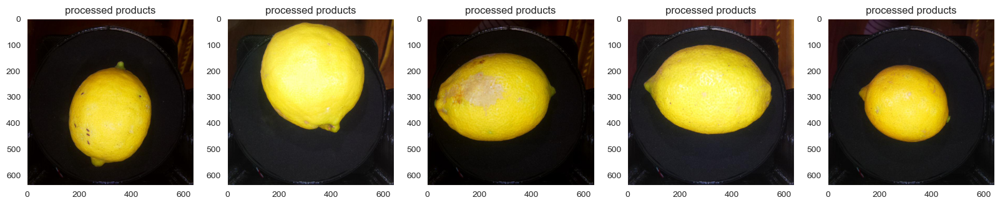

disqualified


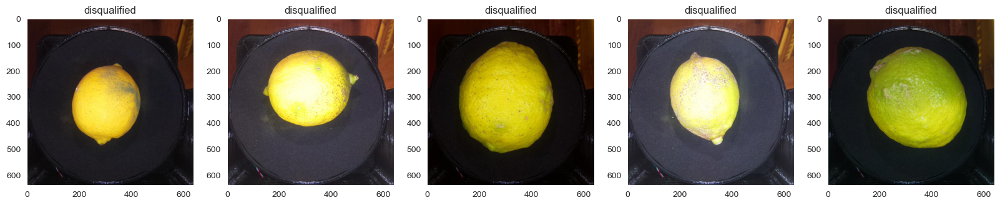

In [61]:
print("Classification results")
for c in class_names:
    ims = np.where(c_test == c)[0][:5]
    print(class_names[c])
    fig = plt.figure(figsize = (20,20)) 
    for i, im in enumerate(ims):
        plt.subplot(1, 5, i+1) #create table of images
        plt.imshow(test[im])
        plt.title(class_names[c])
    plt.show()  

In [62]:
def save_test_result(folder, file, res):
    print(folder + '/' + file)
    ds = pd.read_csv(folder + '/' + file + '.csv')
    ds['Class'] = res
    print(ds)
    ds.to_csv('lemon_results.csv', index=False)
    return 

In [63]:
d = "hiroshima-lemon/hiroshima-lemon"
f = "test_images"
save_test_result(d, f, c_test)

hiroshima-lemon/hiroshima-lemon/test_images
                 id  Class
0     test_0000.jpg      0
1     test_0001.jpg      3
2     test_0002.jpg      0
3     test_0003.jpg      3
4     test_0004.jpg      0
...             ...    ...
1646  test_1646.jpg      3
1647  test_1647.jpg      2
1648  test_1648.jpg      2
1649  test_1649.jpg      0
1650  test_1650.jpg      0

[1651 rows x 2 columns]


In [64]:
'''
Conclusions

In this program we created an expert system with the help of various classifiers, which allows us to perform agricultural products classification. These principles can be used for any image and product types, not just for lemons classification.

and learned how to upload and convert images. We have mastered the extraction of image features and building / selecting / testing / comparing sets of classifiers. We have compared the accuracy of different classifiers.
'''

'\nConclusions\n\nIn this program we created an expert system with the help of various classifiers, which allows us to perform agricultural products classification. These principles can be used for any image and product types, not just for lemons classification.\n\nand learned how to upload and convert images. We have mastered the extraction of image features and building / selecting / testing / comparing sets of classifiers. We have compared the accuracy of different classifiers.\n'